In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy


In [2]:
BASE_DIR="Datasets/anim_images"

In [3]:

image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)


In [4]:
image_paths[:5]

['Datasets/anim_images\\1.png',
 'Datasets/anim_images\\10.png',
 'Datasets/anim_images\\100.png',
 'Datasets/anim_images\\1000.png',
 'Datasets/anim_images\\10000.png']

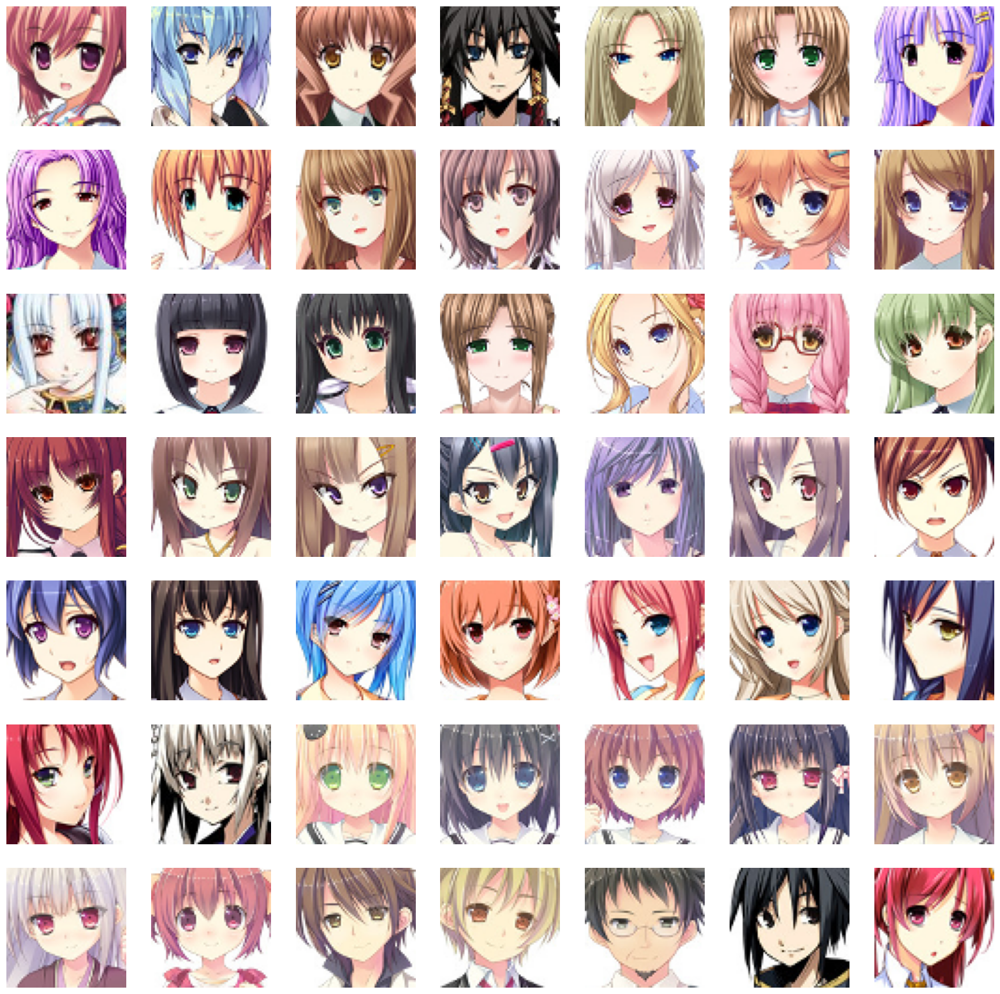

In [5]:
#showing images
plt.figure(figsize=(20,20))
temp_images=image_paths[:49]
index=1
for img_path in temp_images:
    plt.subplot(7,7,index)
    img=load_img(img_path)
    img=np.array(img)
    plt.imshow(img)
    plt.axis('off')
    index+=1

In [6]:
#preprocess image
train_images=[np.array(load_img(path)) for path in tqdm(image_paths)]
train_images=np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [7]:
train_images[0].shape

(64, 64, 3)

In [8]:
train_images=train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [9]:
#normalize images value to -1 to 1
train_images=(train_images-127.5)/127.5

In [10]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

In [48]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [49]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                      │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_4 (ReLU)                       │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_5 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_6 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_5 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_7 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

In [51]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_10               │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_6 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_11               │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_7 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_8 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

In [52]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [53]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [54]:
dcgan=DCGAN(generator=generator,discriminator=discriminator,latent_dim=LATENT_DIM)

In [55]:
#compile the model
D_LR=0.0001
G_LR=0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5),loss_fn=BinaryCrossentropy())


Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 1.2090 - g_loss: 1.9220

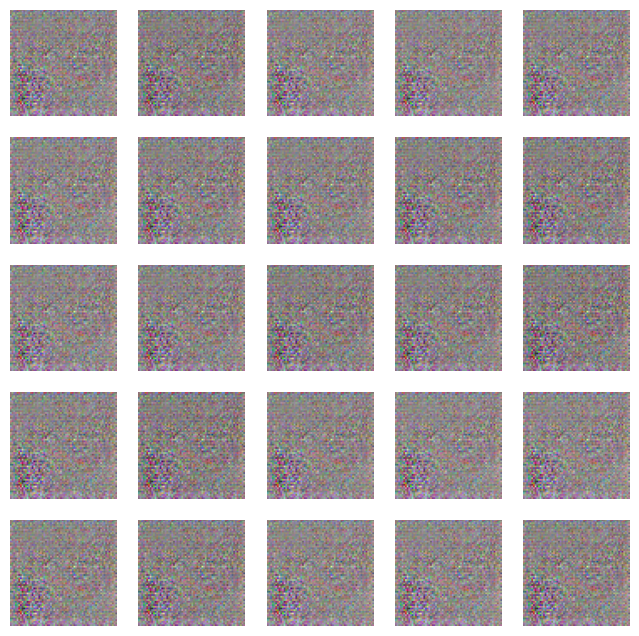

674/674 ━━━━━━━━━━━━━━━━━━━━ 126s 182ms/step - d_loss: 0.5801 - g_loss: 2.8114
Epoch 2/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.1741 - g_loss: 3.3375

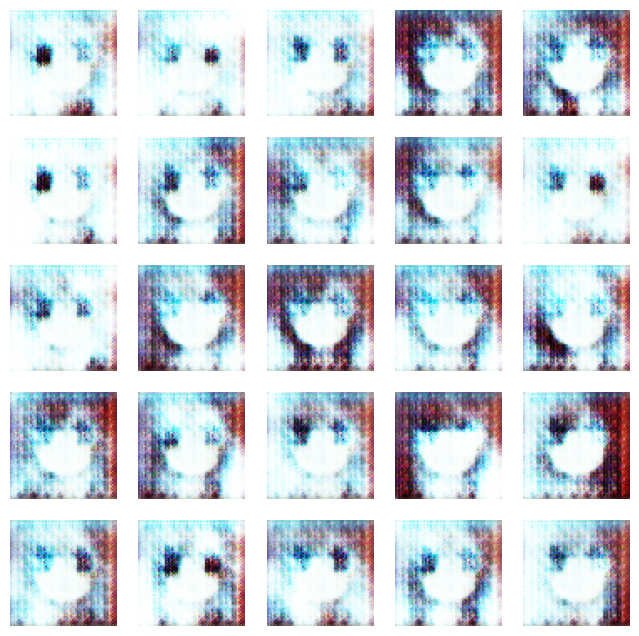

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.3903 - g_loss: 2.6505
Epoch 3/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.5678 - g_loss: 1.8435

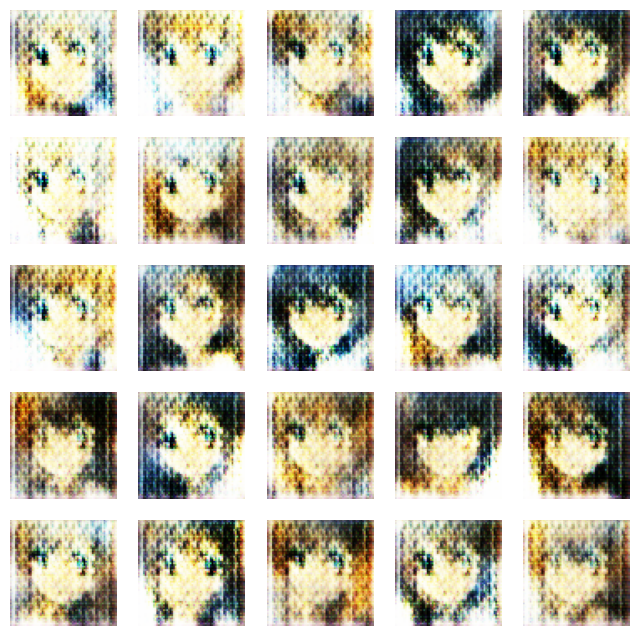

674/674 ━━━━━━━━━━━━━━━━━━━━ 122s 181ms/step - d_loss: 0.5811 - g_loss: 1.7729
Epoch 4/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.5808 - g_loss: 1.7717

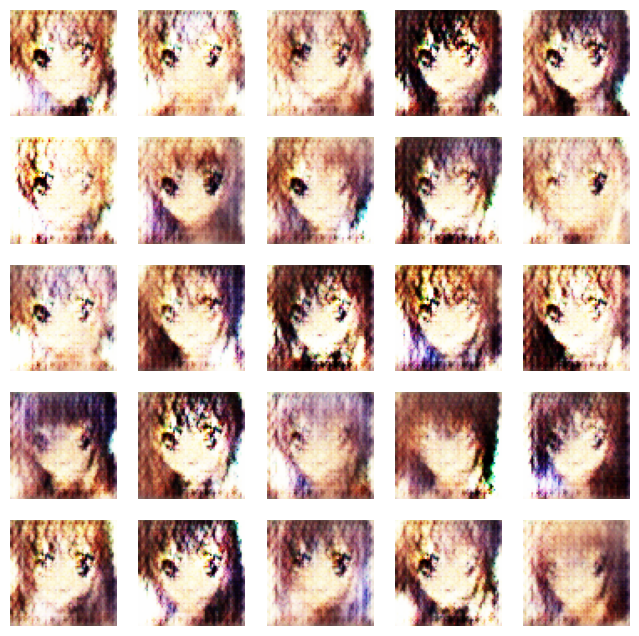

674/674 ━━━━━━━━━━━━━━━━━━━━ 122s 181ms/step - d_loss: 0.5920 - g_loss: 1.7586
Epoch 5/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.5919 - g_loss: 1.7161

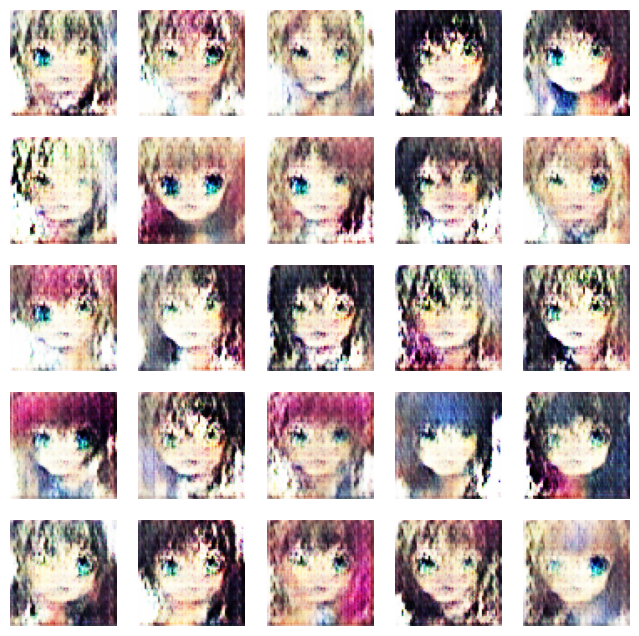

674/674 ━━━━━━━━━━━━━━━━━━━━ 122s 181ms/step - d_loss: 0.5981 - g_loss: 1.6579
Epoch 6/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.6332 - g_loss: 1.4902

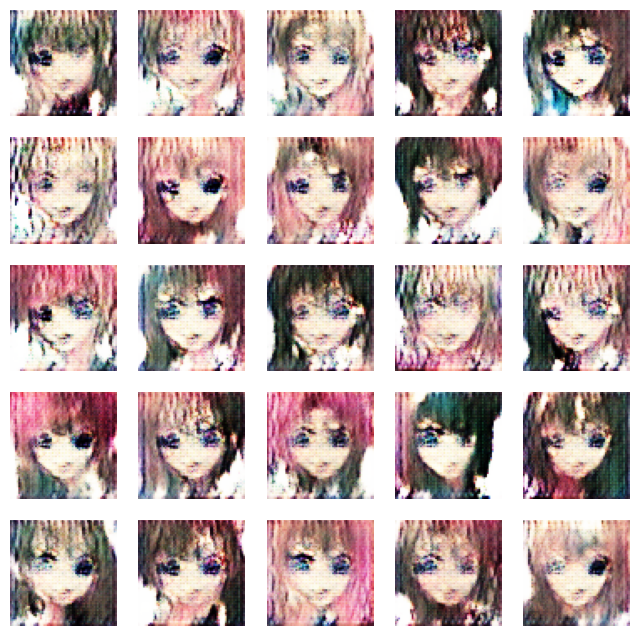

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.6247 - g_loss: 1.4984
Epoch 7/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6230 - g_loss: 1.4761

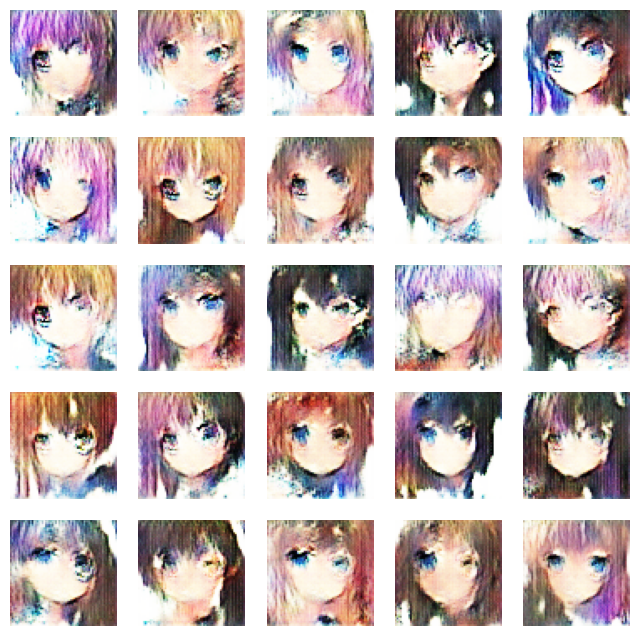

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6401 - g_loss: 1.4131
Epoch 8/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.6787 - g_loss: 1.1858

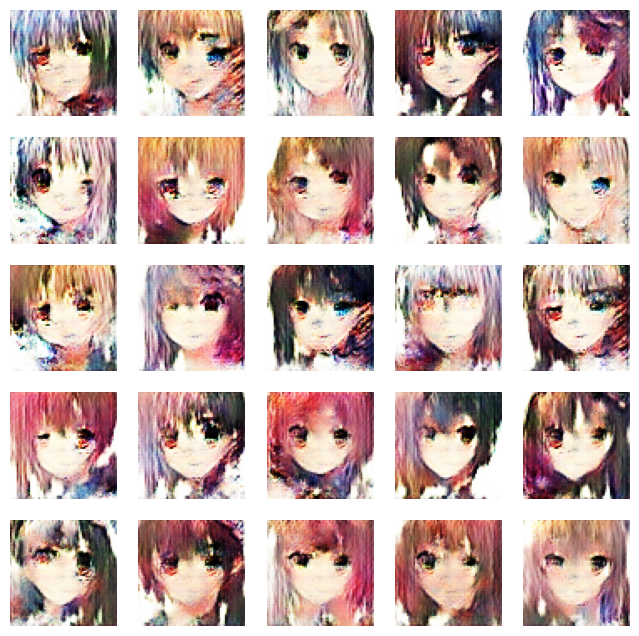

674/674 ━━━━━━━━━━━━━━━━━━━━ 122s 182ms/step - d_loss: 0.6891 - g_loss: 1.1409
Epoch 9/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.6650 - g_loss: 1.1055

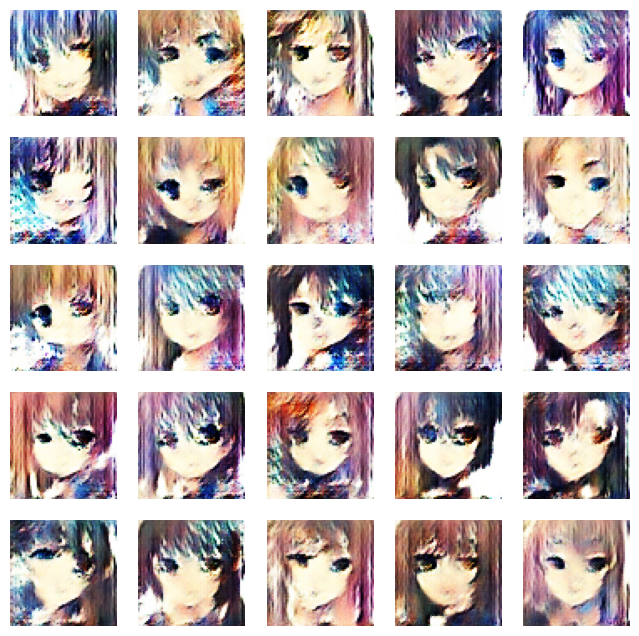

674/674 ━━━━━━━━━━━━━━━━━━━━ 122s 182ms/step - d_loss: 0.6577 - g_loss: 1.1363
Epoch 10/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.7007 - g_loss: 1.0538

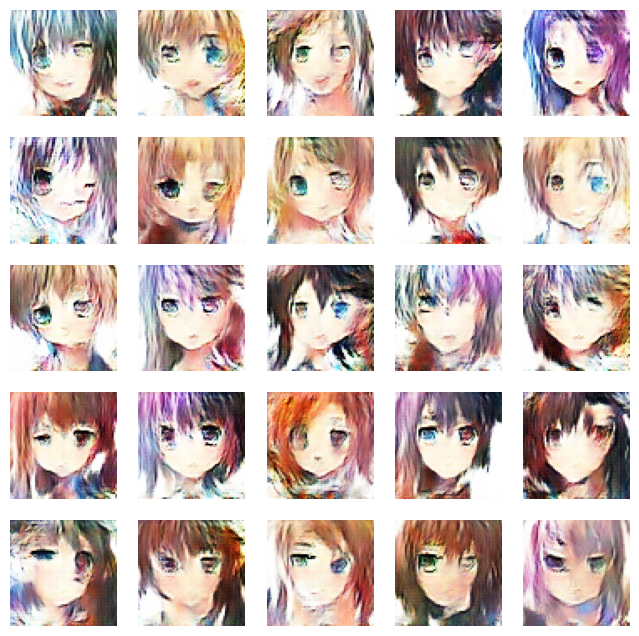

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.7030 - g_loss: 0.9858
Epoch 11/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7212 - g_loss: 0.9087

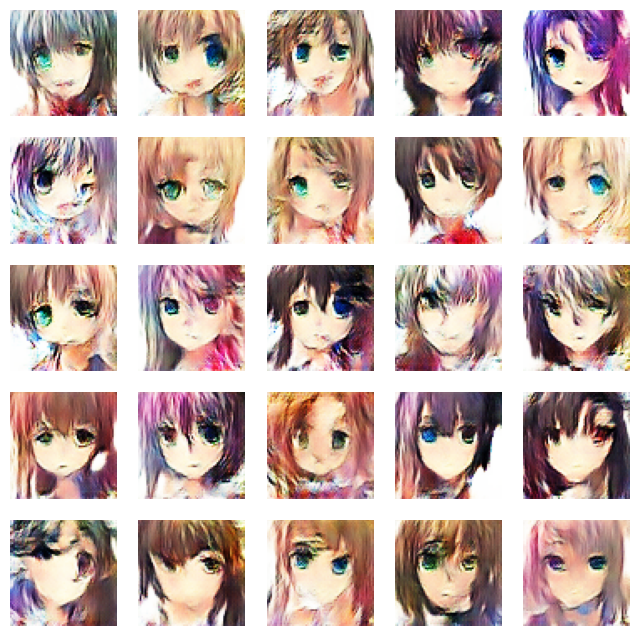

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.7206 - g_loss: 0.8930
Epoch 12/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7230 - g_loss: 0.8482

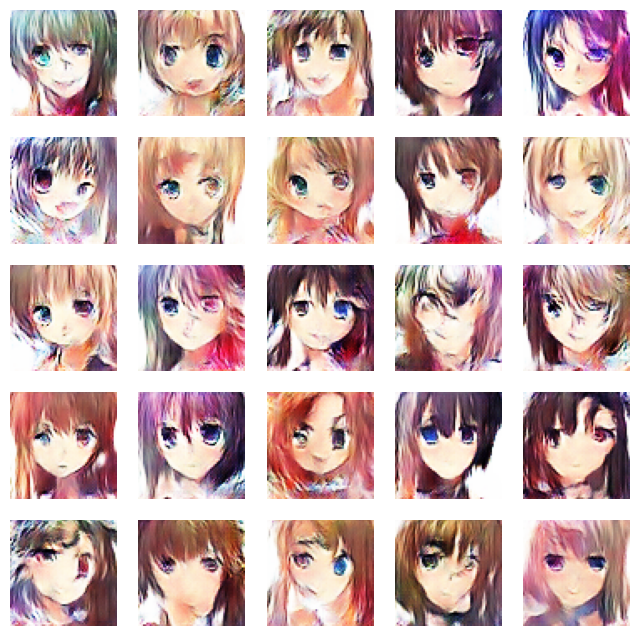

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7212 - g_loss: 0.8379
Epoch 13/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.7158 - g_loss: 0.8262

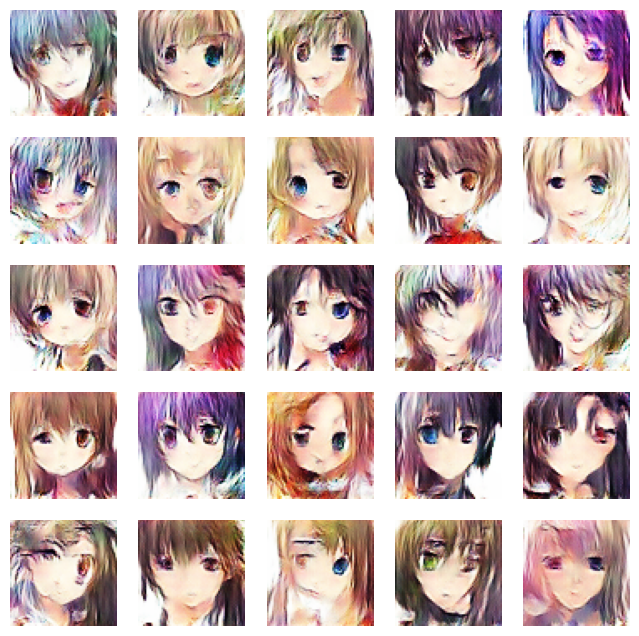

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7180 - g_loss: 0.8171
Epoch 14/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7203 - g_loss: 0.8001

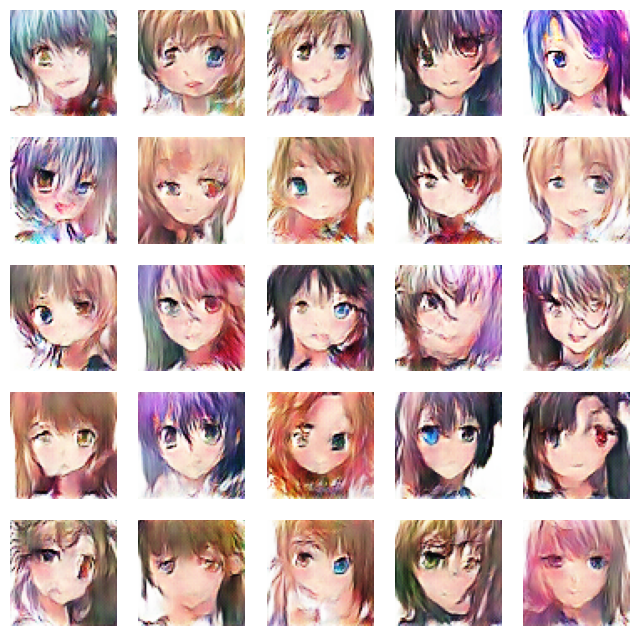

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7184 - g_loss: 0.7916
Epoch 15/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7147 - g_loss: 0.7868

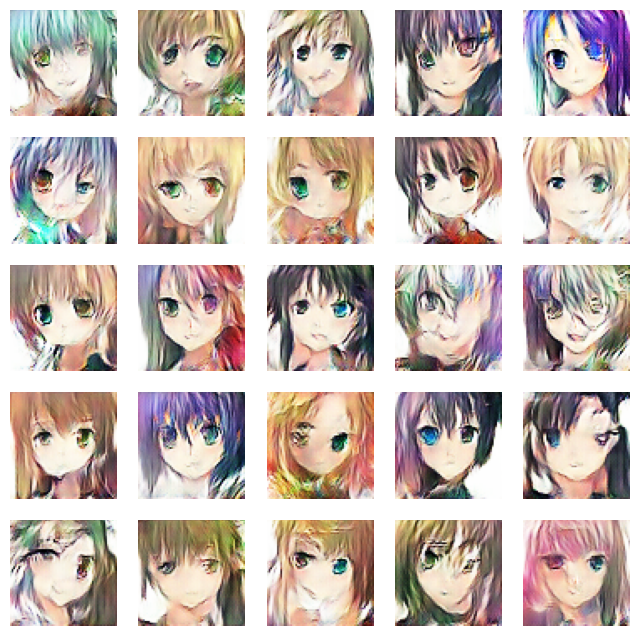

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.7139 - g_loss: 0.7854
Epoch 16/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7116 - g_loss: 0.7806

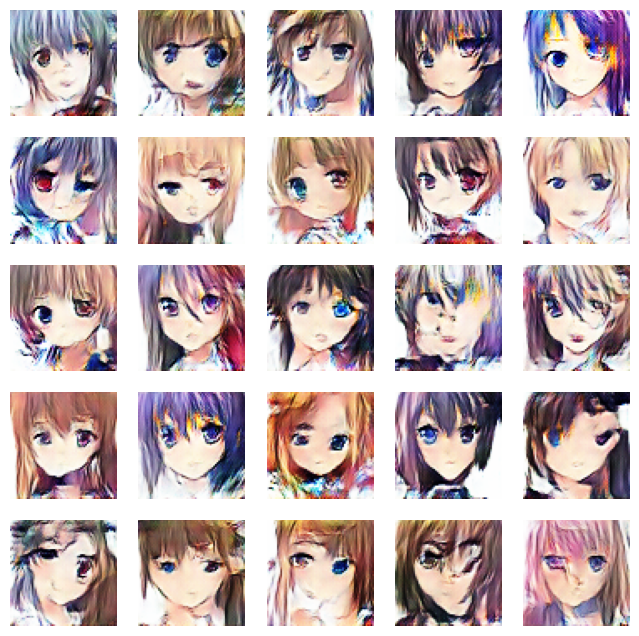

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7107 - g_loss: 0.7743
Epoch 17/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.7052 - g_loss: 0.7689

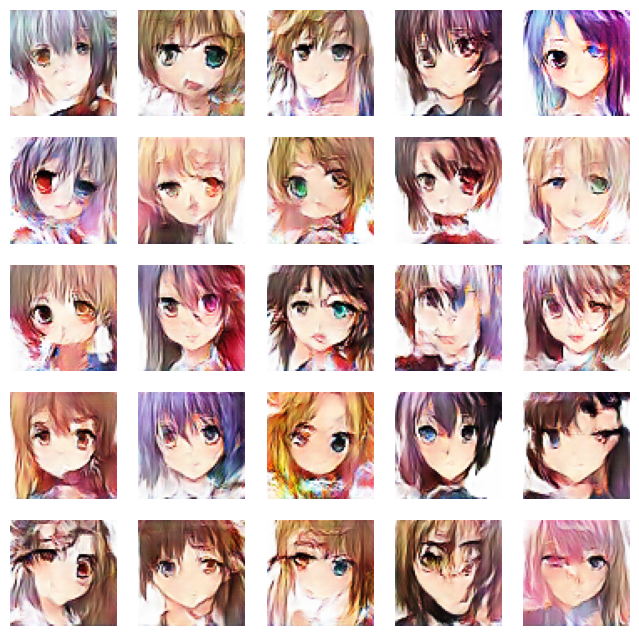

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7055 - g_loss: 0.7667
Epoch 18/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7056 - g_loss: 0.7692

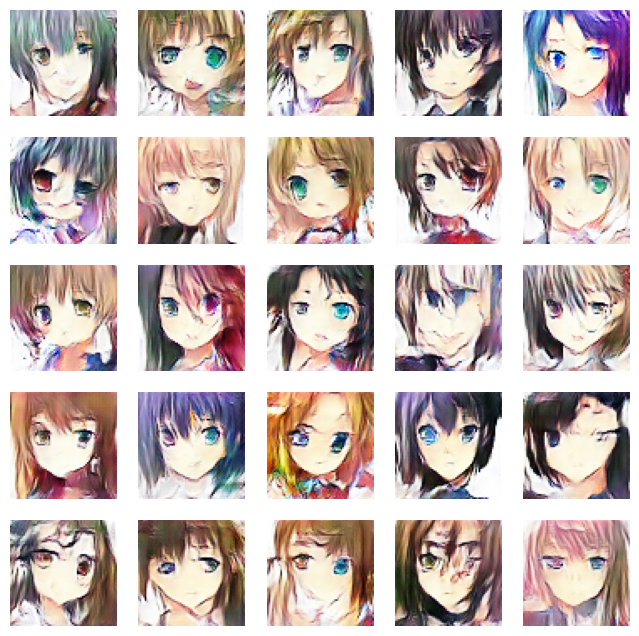

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.7050 - g_loss: 0.7667
Epoch 19/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7044 - g_loss: 0.7584

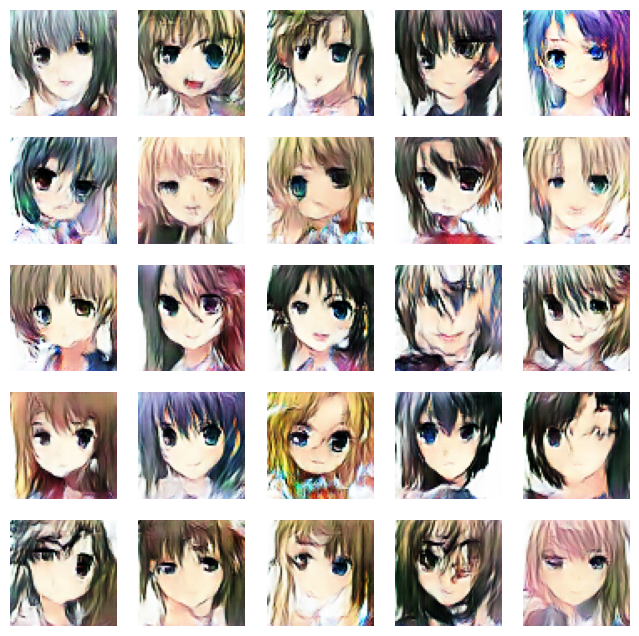

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7040 - g_loss: 0.7606
Epoch 20/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7002 - g_loss: 0.7645

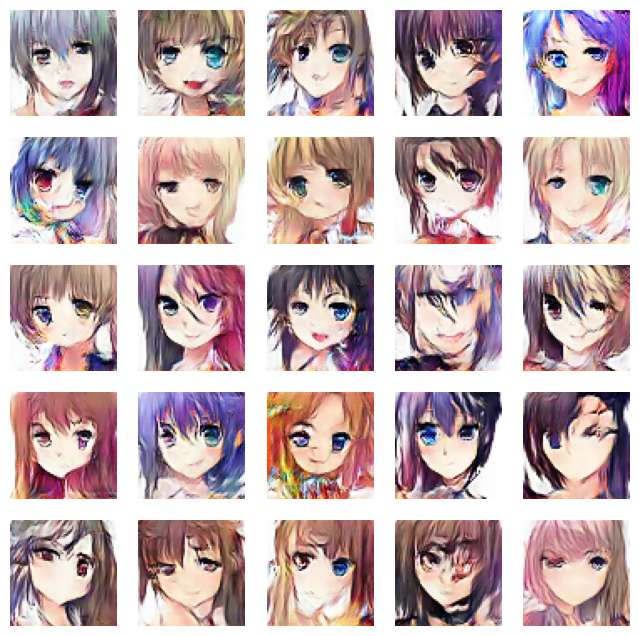

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6999 - g_loss: 0.7615
Epoch 21/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.7008 - g_loss: 0.7654

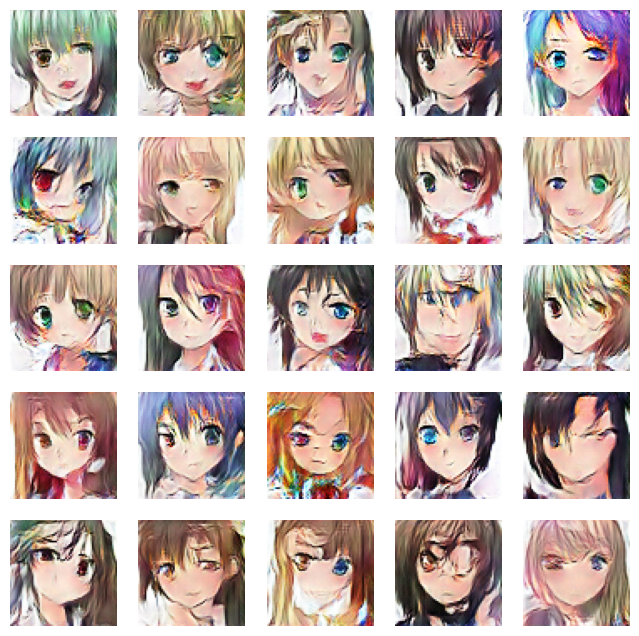

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.7000 - g_loss: 0.7618
Epoch 22/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6968 - g_loss: 0.7696

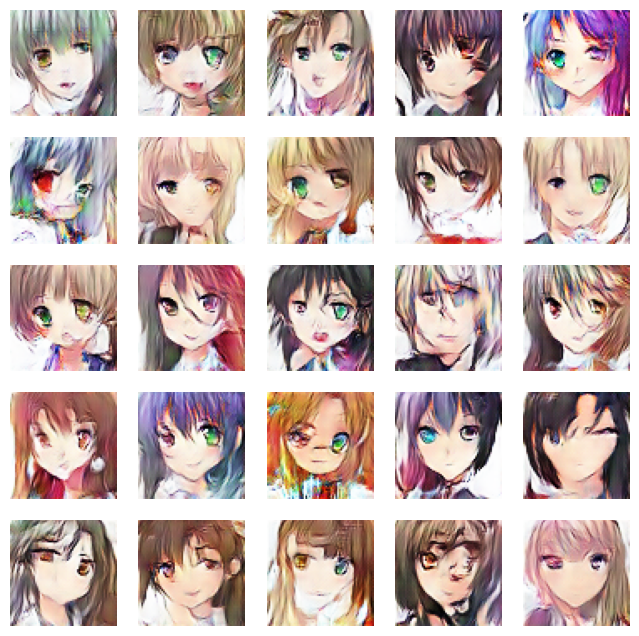

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6969 - g_loss: 0.7639
Epoch 23/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6958 - g_loss: 0.7582

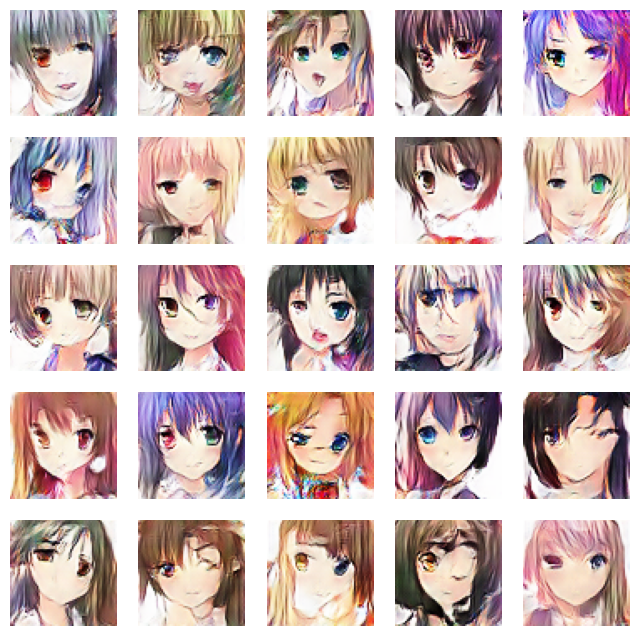

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 182ms/step - d_loss: 0.6941 - g_loss: 0.7601
Epoch 24/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6912 - g_loss: 0.7640

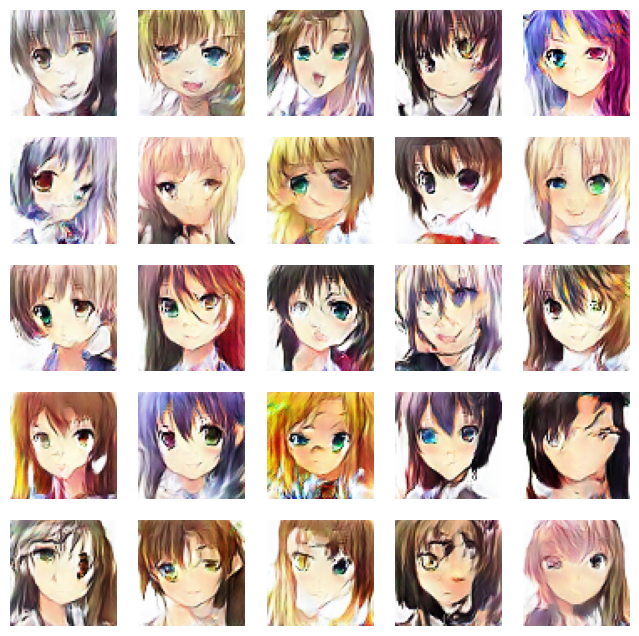

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6930 - g_loss: 0.7665
Epoch 25/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6891 - g_loss: 0.7682

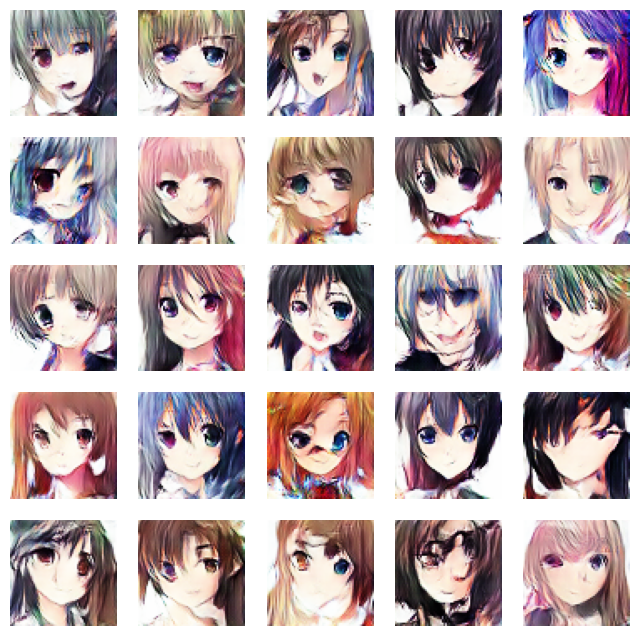

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6885 - g_loss: 0.7704
Epoch 26/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6879 - g_loss: 0.7791

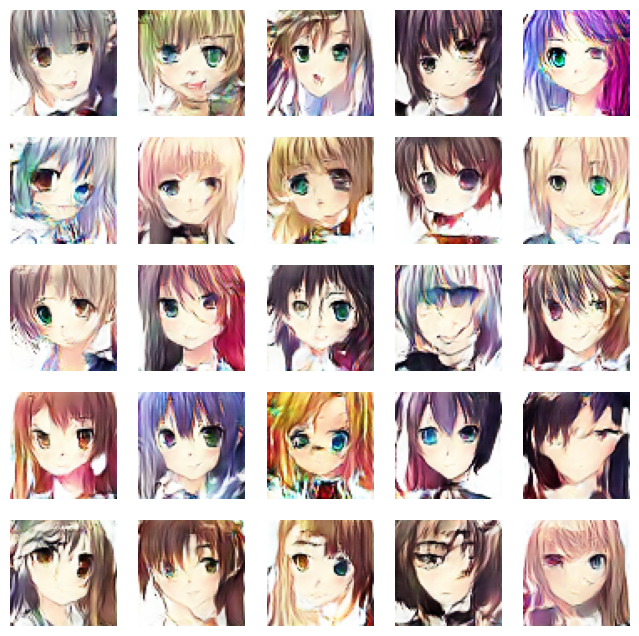

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6878 - g_loss: 0.7790
Epoch 27/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6872 - g_loss: 0.7831

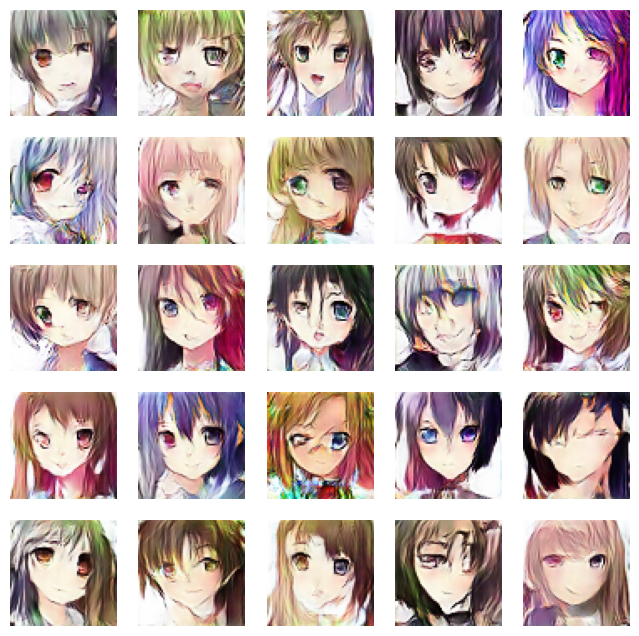

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6854 - g_loss: 0.7850
Epoch 28/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6841 - g_loss: 0.7971

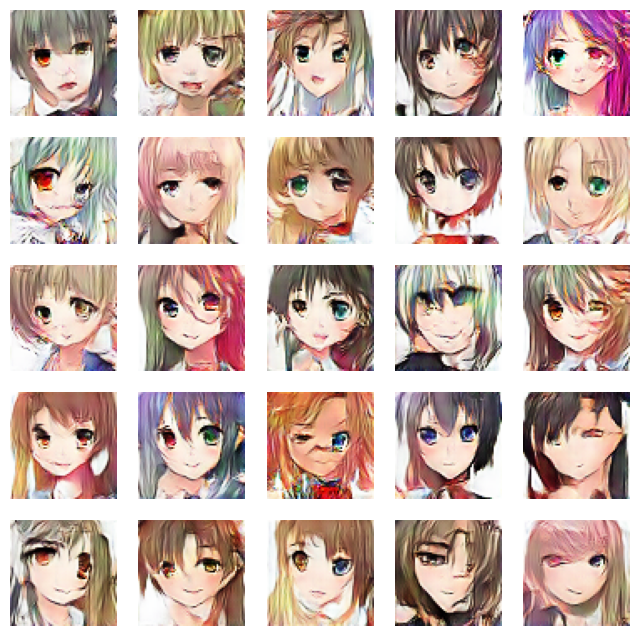

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6827 - g_loss: 0.7929
Epoch 29/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6758 - g_loss: 0.8021

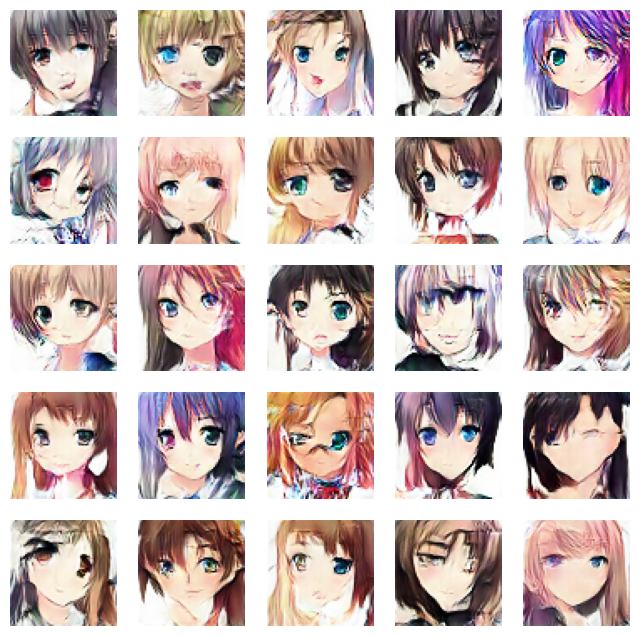

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6765 - g_loss: 0.7989
Epoch 30/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.6765 - g_loss: 0.8042

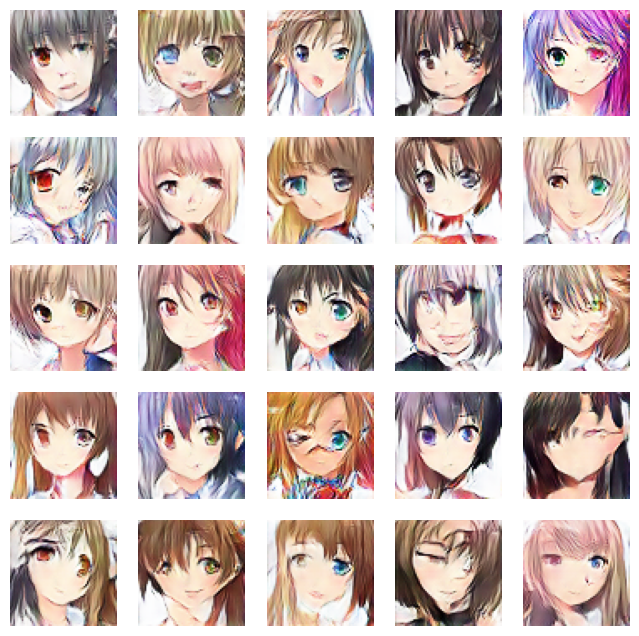

674/674 ━━━━━━━━━━━━━━━━━━━━ 123s 183ms/step - d_loss: 0.6768 - g_loss: 0.8038
Epoch 31/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6749 - g_loss: 0.8155

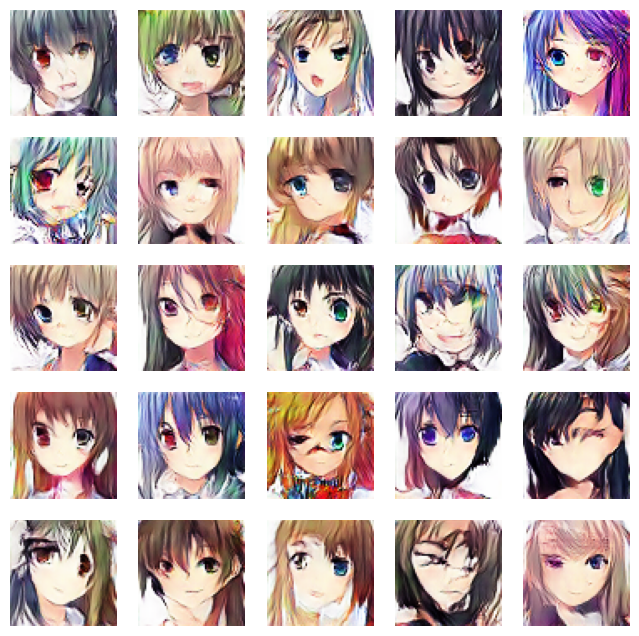

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6743 - g_loss: 0.8138
Epoch 32/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6638 - g_loss: 0.8246

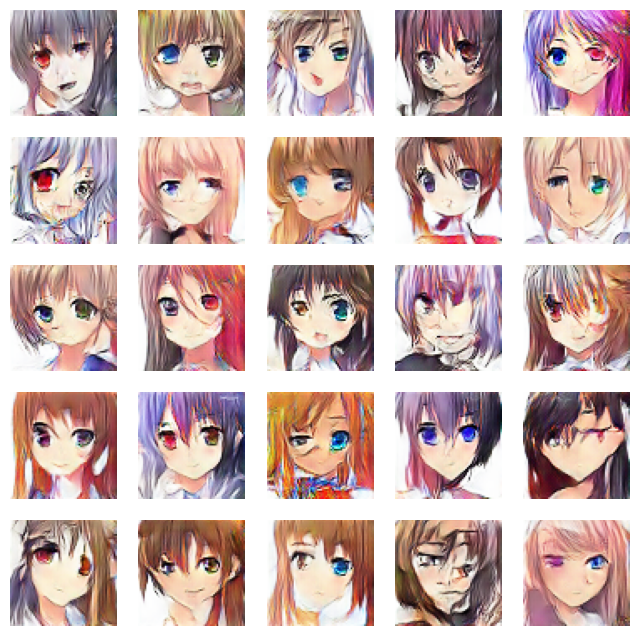

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6648 - g_loss: 0.8289
Epoch 33/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6619 - g_loss: 0.8433

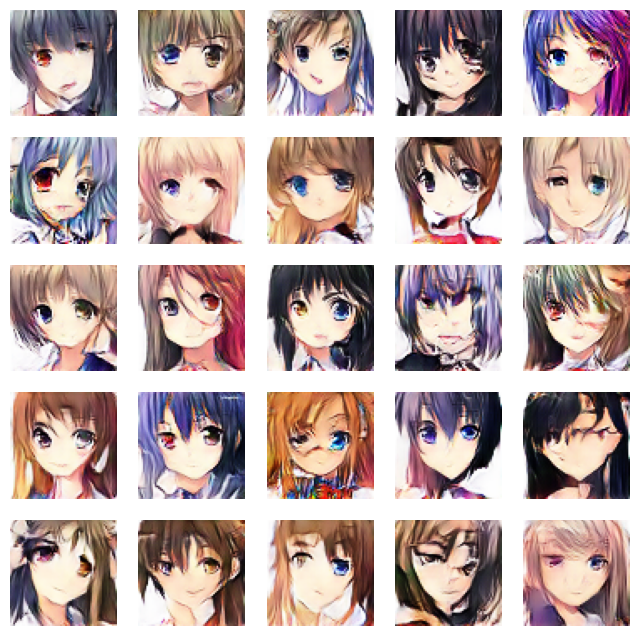

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 183ms/step - d_loss: 0.6627 - g_loss: 0.8460
Epoch 34/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6544 - g_loss: 0.8529

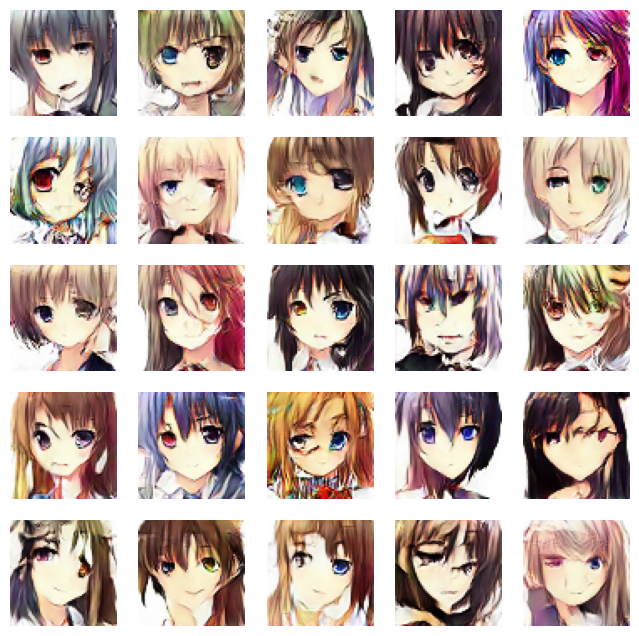

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 183ms/step - d_loss: 0.6555 - g_loss: 0.8600
Epoch 35/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6541 - g_loss: 0.8730

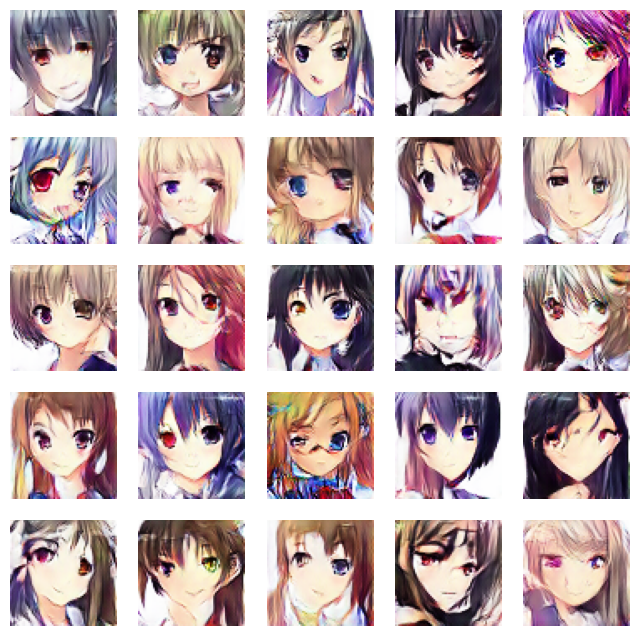

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 183ms/step - d_loss: 0.6535 - g_loss: 0.8742
Epoch 36/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6497 - g_loss: 0.8860

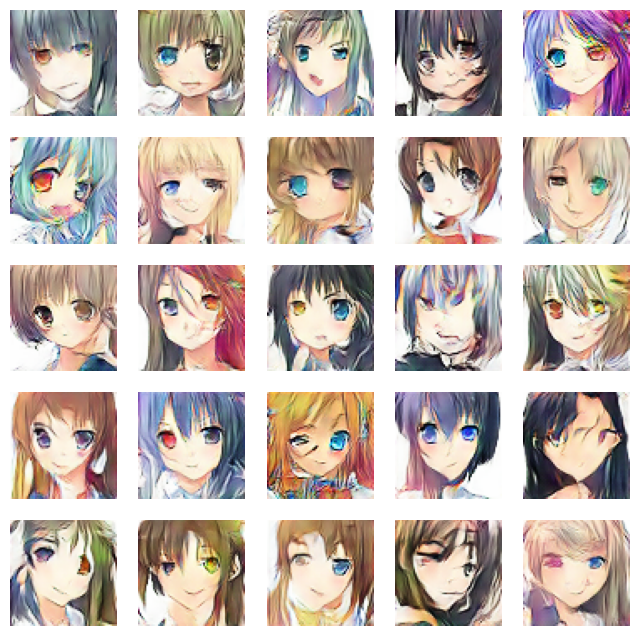

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 183ms/step - d_loss: 0.6484 - g_loss: 0.8844
Epoch 37/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.6441 - g_loss: 0.9013

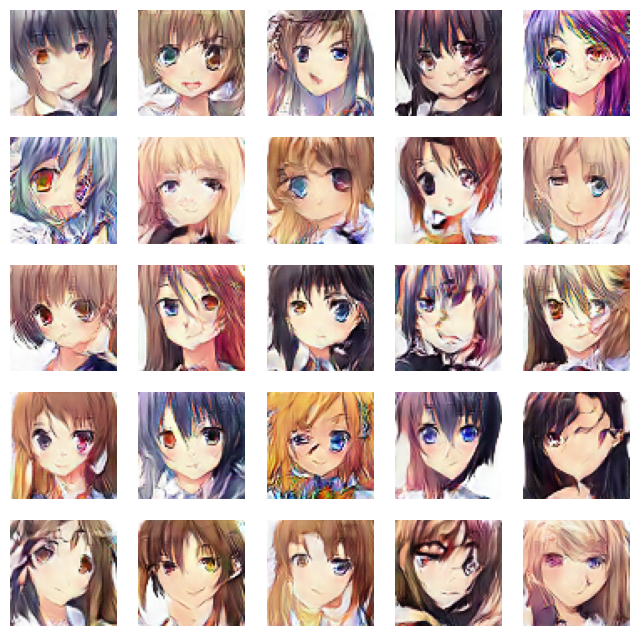

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6440 - g_loss: 0.9013
Epoch 38/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6418 - g_loss: 0.9151

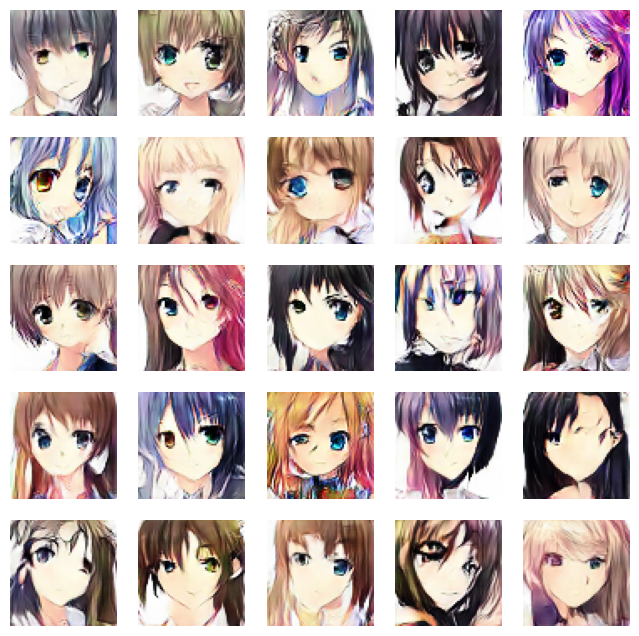

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6403 - g_loss: 0.9130
Epoch 39/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6317 - g_loss: 0.9256

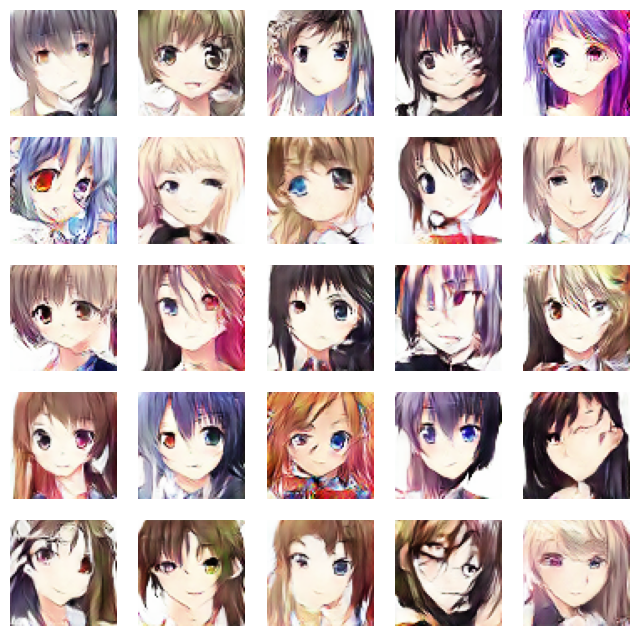

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6348 - g_loss: 0.9247
Epoch 40/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6335 - g_loss: 0.9380

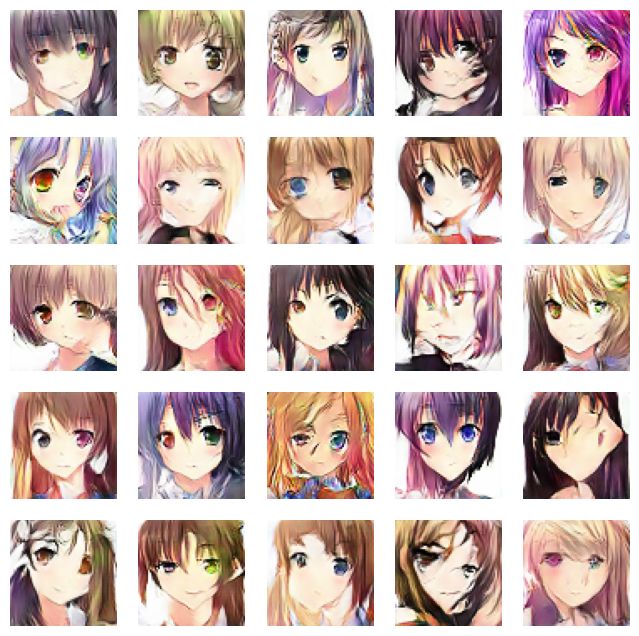

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6310 - g_loss: 0.9379
Epoch 41/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6233 - g_loss: 0.9568

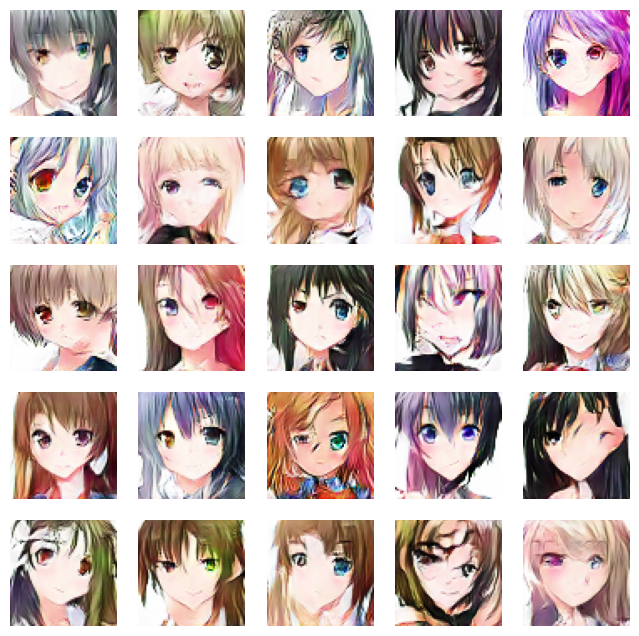

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 185ms/step - d_loss: 0.6263 - g_loss: 0.9568
Epoch 42/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6249 - g_loss: 0.9754

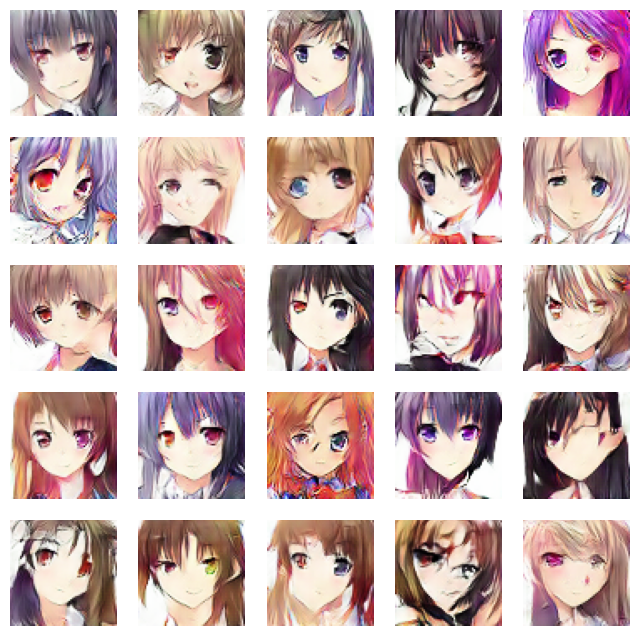

674/674 ━━━━━━━━━━━━━━━━━━━━ 124s 184ms/step - d_loss: 0.6243 - g_loss: 0.9716
Epoch 43/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6148 - g_loss: 0.9787

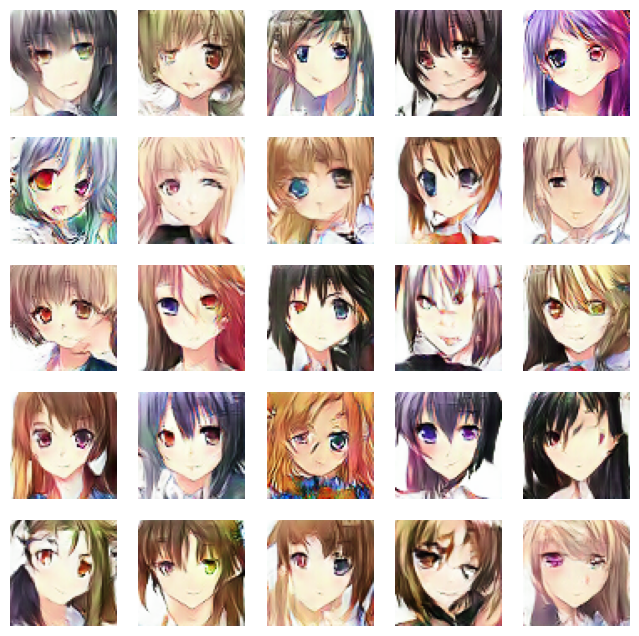

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.6180 - g_loss: 0.9800
Epoch 44/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.6122 - g_loss: 1.0038

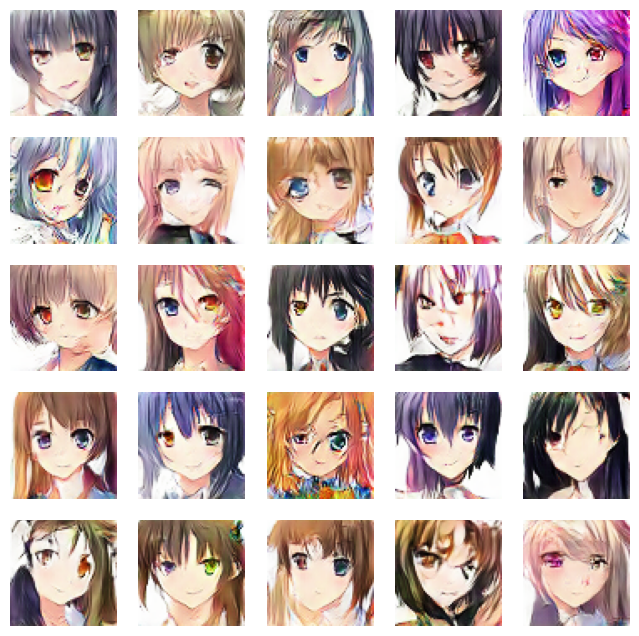

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.6140 - g_loss: 1.0010
Epoch 45/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.6050 - g_loss: 1.0132

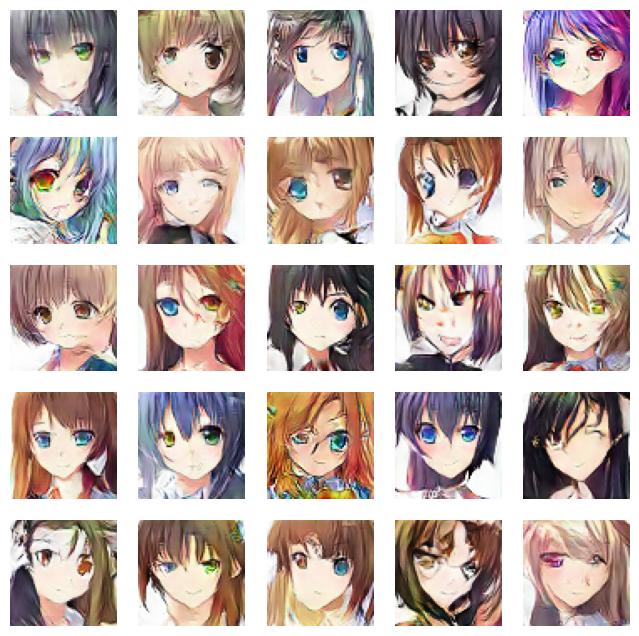

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.6076 - g_loss: 1.0158
Epoch 46/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.6030 - g_loss: 1.0241

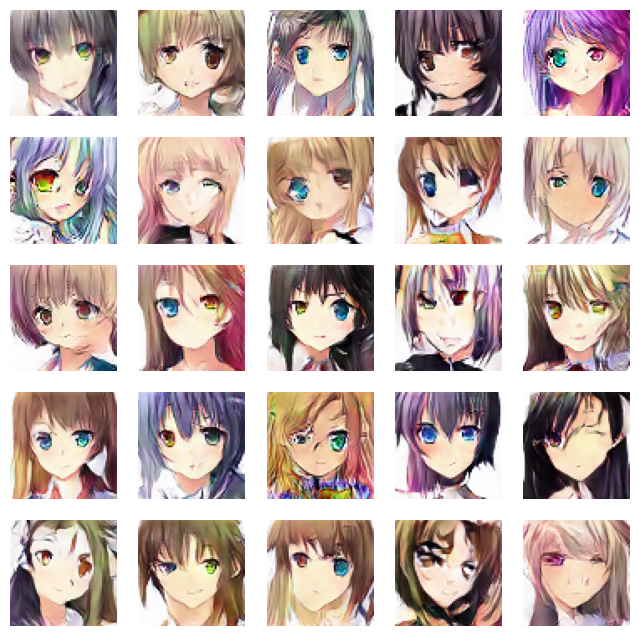

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.6035 - g_loss: 1.0251
Epoch 47/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.6011 - g_loss: 1.0431

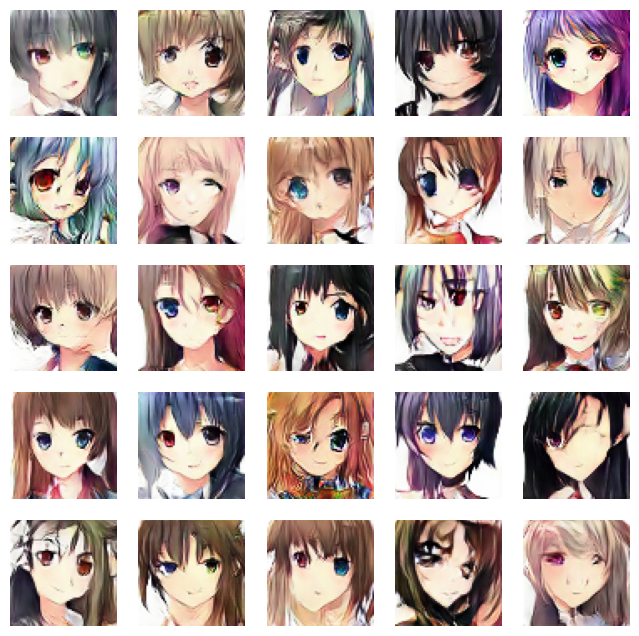

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.6013 - g_loss: 1.0419
Epoch 48/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.5960 - g_loss: 1.0618

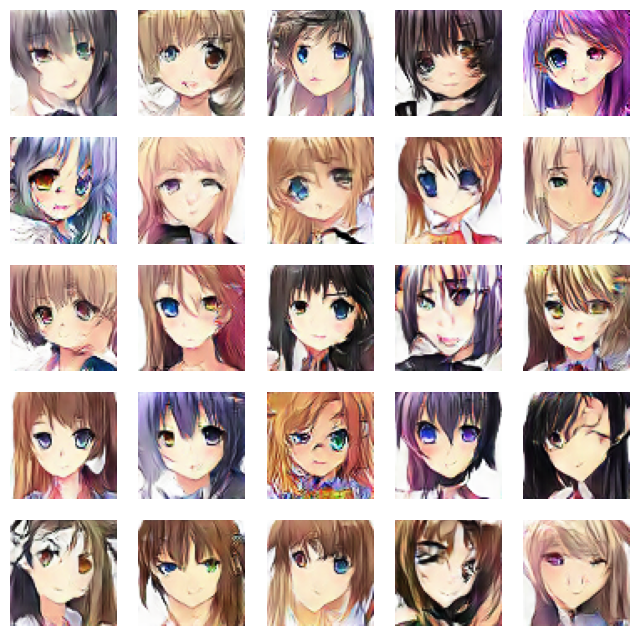

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 186ms/step - d_loss: 0.5970 - g_loss: 1.0601
Epoch 49/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.5945 - g_loss: 1.0748

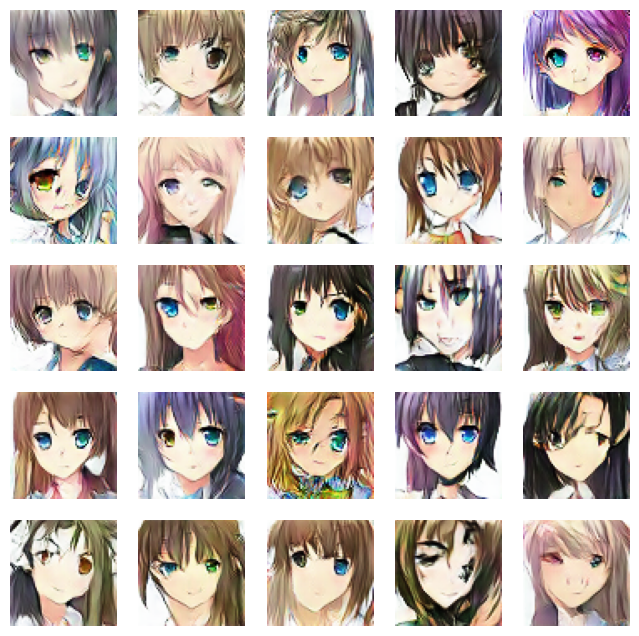

674/674 ━━━━━━━━━━━━━━━━━━━━ 125s 185ms/step - d_loss: 0.5931 - g_loss: 1.0766
Epoch 50/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.5880 - g_loss: 1.0840

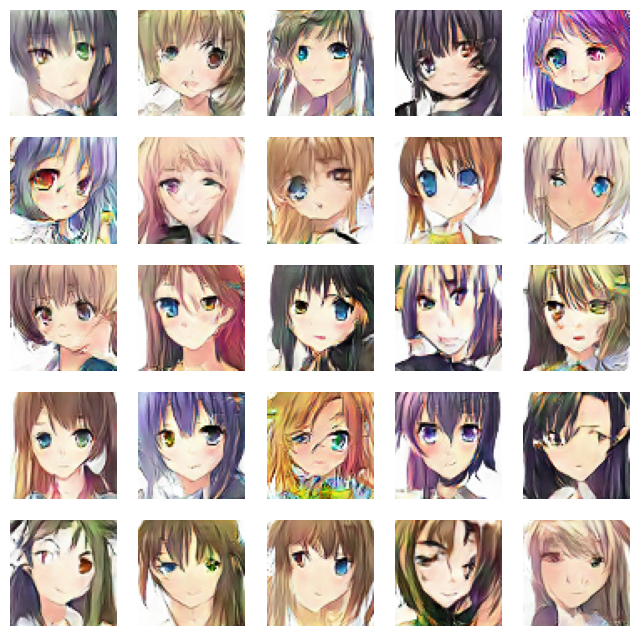

674/674 ━━━━━━━━━━━━━━━━━━━━ 126s 186ms/step - d_loss: 0.5897 - g_loss: 1.0882


In [56]:
N_EPOCHS=50
dcgan.fit(train_images,epochs=N_EPOCHS,callbacks=[DCGANMonitor()])

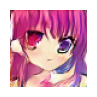

In [66]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(1, 1))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()